# Crop Field One Class with Graph-based segmentation

This notebook is part of the field boundary detection project. The goal is to evaluate the algorithm using single samples (1D) instead of 2D combining time series of the same h3 hex AND semi-supervised contrastive learning with Graph-based segmentation.

## Summary
[1. Data Processing](#data_processing)

[2. Model Training](#model_training)

[3. Graph Based Segmenation](#graphbased_segmentation)

## Load required libraries

In [1]:
import sys

# Install packages required only once
install_packages = False

if install_packages:
    !{sys.executable} -m pip install sklearn
    !{sys.executable} -m pip install seaborn
    !{sys.executable} -m pip install imblearn

In [2]:
import math
import matplotlib.pyplot as plt
from matplotlib import pyplot

import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow import keras
from tensorflow.keras import layers

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

import pandas as pd
import numpy as np

import folium
import h3

## Hyper-parameters and other constants

In [3]:
temporal_samples = 15
band_features = ['B01', 'B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B09', 'B11', 'B12']

width = 60 # output vector size
temperature = 0.1 # empirical temperature value

steps_per_epoch = 10
AUTOTUNE = tf.data.AUTOTUNE
shuffle_buffer = 5
num_epochs = 20

queue_size = 10000
kernel_size = 3
strides = 1

# Stronger augmentations for contrastive, weaker ones for supervised training
contrastive_augmentation = {"jitter": 0.3}
classification_augmentation = {"jitter": 0.1}

<a id='data_processing'></a>

# 1. Data Processing

<div>
<img border="5px" src="../res/dataprocessing.png" width="1000"/>
</div>

## Configure the train and test datasets

In [4]:
from pathlib import Path

positive_samples_folder = Path('D:\\173_seeding_harvest_joined_USCA_mini.parquet\\positive_samples\\hex_index_L3=8348b3fffffffff')
negative_samples_folder = Path('D:\\173_seeding_harvest_joined_USCA_mini.parquet\\negative_samples\\hex_index_L3=8348b3fffffffff')

## Load all parquet files from the configured folder

In [5]:
df_positive = pd.concat(
            pd.read_parquet(parquet_file)
            for parquet_file in positive_samples_folder.rglob('*.parquet')
         )

df_negative = pd.concat(
            pd.read_parquet(parquet_file)
            for parquet_file in negative_samples_folder.rglob('*.parquet'))

print('The shape of loaded positive dataframe is:', df_positive.shape)
print('The shape of loaded negative dataframe is:', df_negative.shape)

df_positive = df_positive.drop_duplicates()
df_negative = df_negative.drop_duplicates()

df_positive['timestamp'] = df_positive.scene_id.str[11:26]
df_negative['timestamp'] = df_negative.scene_id.str[11:26]

print('The shape of loaded positive dataframe is:', df_positive.shape)
print('The shape of loaded negative dataframe is:', df_negative.shape)

display(df_positive.head(5))
display(df_negative.head(5))

The shape of loaded positive dataframe is: (98148, 19)
The shape of loaded negative dataframe is: (74163, 19)
The shape of loaded positive dataframe is: (98148, 20)
The shape of loaded negative dataframe is: (74163, 20)


,start_date,end_date,FIELD_OPERATION_GUID,scene_id,hex,SCL_val,s2_tile,B01,B02,B03,B04,B05,B06,B07,B08,B8A,B09,B11,B12,timestamp
0,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c13ff,4,14RPQ,521.0,536.0,1036.0,634.0,1486.0,3316.0,3837.0,3984.0,4040.0,3963.0,2649.0,1518.0,20181029T170421
1,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c17ff,4,14RPQ,521.0,537.0,1036.0,638.0,1504.0,3390.0,3843.0,3842.0,4074.0,3963.0,2607.0,1495.0,20181029T170421
2,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c23ff,4,14RPQ,527.0,565.0,849.0,753.0,1390.0,2555.0,2796.0,2536.0,3128.0,3746.0,2583.0,1605.0,20181029T170421
3,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c27ff,4,14RPQ,556.0,509.0,979.0,736.0,1462.0,2922.0,3187.0,3292.0,3500.0,3856.0,2598.0,1540.0,20181029T170421
4,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c31ff,4,14RPQ,527.0,536.0,1011.0,660.0,1512.0,3284.0,3733.0,3654.0,3985.0,3746.0,2603.0,1538.0,20181029T170421


,start_date,end_date,FIELD_OPERATION_GUID,scene_id,hex,SCL_val,s2_tile,B01,B02,B03,B04,B05,B06,B07,B08,B8A,B09,B11,B12,timestamp
0,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c01ff,5,14RPQ,888.0,1034.0,1458.0,1546.0,1956.0,3277.0,3696.0,4004.0,3844.0,3662.0,3317.0,2241.0,20181029T170421
1,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c03ff,4,14RPQ,888.0,934.0,1272.0,1340.0,1669.0,2765.0,3081.0,2800.0,3364.0,3662.0,2883.0,1914.0,20181029T170421
2,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c05ff,4,14RPQ,888.0,1042.0,1458.0,1552.0,1903.0,3050.0,3344.0,3124.0,3636.0,3662.0,3379.0,2425.0,20181029T170421
3,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c07ff,4,14RPQ,888.0,956.0,1256.0,1370.0,1643.0,2492.0,2738.0,2832.0,3076.0,3662.0,2916.0,2007.0,20181029T170421
4,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c0bff,4,14RPQ,760.0,916.0,1368.0,1090.0,1844.0,3406.0,3768.0,4232.0,4069.0,3958.0,3155.0,1978.0,20181029T170421


In [6]:
print('In this dataset there are ', df_positive.hex.unique().size, ' different positive hexes')
print('In this dataset there are ', df_negative.hex.unique().size, ' different negative hexes')

positive_l12_hexes = df_positive.hex.unique()
negative_l12_hexes = df_negative.hex.unique()

ambiguous_l12_hexes = set(positive_l12_hexes).intersection(negative_l12_hexes)
print('There are ', len(ambiguous_l12_hexes), ' hexes labeled both as positive and negative')

In this dataset there are  4939  different positive hexes
In this dataset there are  3772  different negative hexes
There are  184  hexes labeled both as positive and negative


In [7]:
df_positive = df_positive[~df_positive['hex'].isin(ambiguous_l12_hexes)]
df_negative = df_negative[~df_negative['hex'].isin(ambiguous_l12_hexes)]

print('In this dataset there are ', df_positive.hex.unique().size, ' different positive hexes')
print('In this dataset there are ', df_negative.hex.unique().size, ' different negative hexes')

In this dataset there are  4755  different positive hexes
In this dataset there are  3588  different negative hexes


There are hexes with temporal samples from :  16  to  37


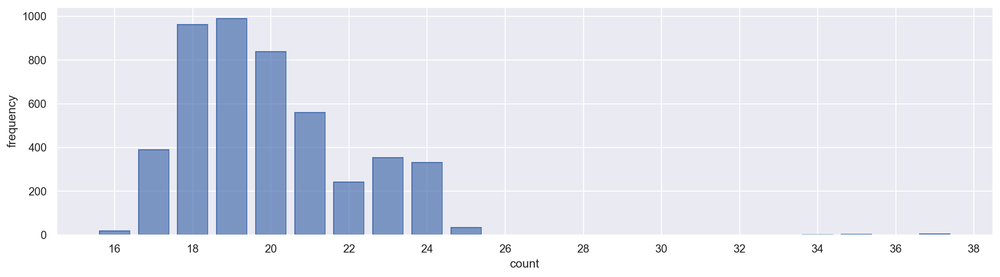

In [8]:
import seaborn.objects as so
import seaborn as sns

sns.set(rc={'figure.figsize':(18.7,18.27)})

temporal_samples_count = df_positive.groupby(['hex'])['hex'].count()
print('There are hexes with temporal samples from : ', min(temporal_samples_count), ' to ', max(temporal_samples_count))

hist = pd.DataFrame(temporal_samples_count) \
        .rename(columns={'hex': 'count'}) \
        .reset_index(level=0) \
        .groupby(['count'])['count'].count()

hist_df = pd.DataFrame(hist) \
          .rename(columns={'count': 'frequency'}) \
          .reset_index(level=0)

so.Plot(hist_df["count"], hist_df["frequency"]) \
    .add(so.Bar()) \
    .scale(x=so.Continuous().tick(every=2)) \
    .layout(size=(14, 4))

## Sentinel 2 bands
These are the 12 bands contained in the parque files and their respective meanings

<div>
<img src="../res/sentinel2-bands.png" width="500"/>
</div>

## Dataset cleaning

In [9]:
if True:
    # Drop hexes from non-conclusive areas
    drop_list = np.loadtxt('drop_list.csv', delimiter=',', dtype='str')

    df_negative = df_negative[~df_negative['hex'].isin(drop_list)]
    df_positive = df_positive[~df_positive['hex'].isin(drop_list)]
    


if True:
    # Treat false negatives
    false_negatives = np.loadtxt('false_negatives.csv', delimiter=',', dtype='str')

    df_negative = df_negative.assign(label=0)
    df_positive = df_positive.assign(label=1)

    print(sum(df_negative.label==1), sum(df_negative.label==0))
    
    df_negative = df_negative.reset_index()
    df_positive = df_positive.reset_index()
    # Assign to negatives recognized as false the label 1
    df_negative.loc[df_negative['hex'].isin(false_negatives), 'label'] = 1
    
    print(sum(df_negative.label==1), sum(df_negative.label==0))

    df_positive = pd.concat([df_positive, df_negative[df_negative.label==1]])
    
    df_negative = df_negative.drop(df_negative[df_negative.label == 1].index)


0 56562
16080 40482


In [10]:
if False:
    false_negatives = np.loadtxt('falsenegatives.csv', delimiter=',', dtype='str')

    df_negative = df_negative.assign(label=0)
    df_positive = df_positive.assign(label=1)

    print(sum(df_negative.label==1), sum(df_negative.label==0))

    df_negative.loc[df_negative['hex'].isin(false_negatives), 'label'] = 1

    print(sum(df_negative.label==1), sum(df_negative.label==0))
    
    
    df_positive = pd.concat([df_positive, df_negative[df_negative.label==1]])
    df_negative = df_negative.drop(df_negative[df_negative.label == 1].index)

## Show some of the L12 hexes loaded in the folium map

In [11]:
h3_hex = h3.h3_to_parent(df_positive.iloc[0]['hex'], 3)

center = h3.h3_to_geo_boundary(h=h3_hex,geo_json=True)

hexes_to_print=5000
df_positive_single_hex = df_positive.drop_duplicates(subset='hex', keep="first").head(hexes_to_print)
df_negative_single_hex = df_negative.drop_duplicates(subset='hex', keep="first").head(hexes_to_print)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                zoom_start=17,
                overlay = False,
                control = True)

# Print h3 hex
geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=h3_hex,geo_json=True)]}
geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'white', 'color': 'white', 'weight': 0.5})
geo_j.add_to(m)

# Print positive samples
for index, row in df_positive_single_hex.iterrows():
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'yellow', 'color': 'green', 'weight': 0.5})
    folium.Popup(str(row['hex'])).add_to(geo_j)
    geo_j.add_to(m)
    
# Print negative samples
for index, row in df_negative_single_hex.iterrows():
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'black', 'weight': 0.5})
    folium.Popup('<a href target="_blank">https://www.google.com/search?q=' + str(row['hex']) + '</a>').add_to(geo_j)
    geo_j.add_to(m)

m

## Group samples in a 2D (band x imgdate) matrix

In [12]:
number_of_bands = len(band_features)

# Keep only [temporal samples] samples 
df_positive = df_positive.sort_values(by=['hex'])
df_positive = df_positive.groupby('hex').head(temporal_samples)

df_negative = df_negative.sort_values(by=['hex'])
df_negative = df_negative.groupby('hex').head(temporal_samples)

# Associate labels picked manually
df_negative = df_negative.assign(label=0)
df_positive = df_positive.assign(label=1)
df = pd.concat([df_positive, df_negative], axis=0)

df[band_features] = StandardScaler().fit_transform(df[band_features])

#display(df[['hex'] + band_features + ['timestamp']].head(temporal_samples))

# Organize the 2D samples in numpy arrays
sample = np.zeros((temporal_samples, number_of_bands), dtype=np.float64)
X_array = np.empty((0, temporal_samples, number_of_bands),  dtype=np.float64)

labels = []
hexes = []
timestamp_tracking = []
timestamp_sample = []

sub_index = 0
for index, row in df.iterrows():
        print(index, end='\r')
        # fill the band values in a temporal row
        for idx,b in enumerate(band_features):
            sample[sub_index][idx] = row[b]

        timestamp_sample.append(row.timestamp)
         
        # increment row number 
        sub_index = sub_index + 1
        
        # if reached last row of temporal samples, increment to next sample
        if sub_index == temporal_samples:
            shuffler = np.random.permutation(sample.shape[0])
            sample = sample[shuffler]
            timestamp_sample = list(np.array(timestamp_sample)[shuffler])

            if len(timestamp_sample) != temporal_samples:
                print('Invalid sample!')

            X_array = np.append(X_array, [sample], axis=0)

            labels.append(row.label)
            hexes.append(row.hex)
            timestamp_tracking.append(timestamp_sample.copy())            
            timestamp_sample.clear()
            sub_index = 0

print(X_array.shape)
print(len(labels))
print(len(hexes))

(7115, 15, 12)
7115
7115


## Visualize the samples in the space reduced to 2 dimensions

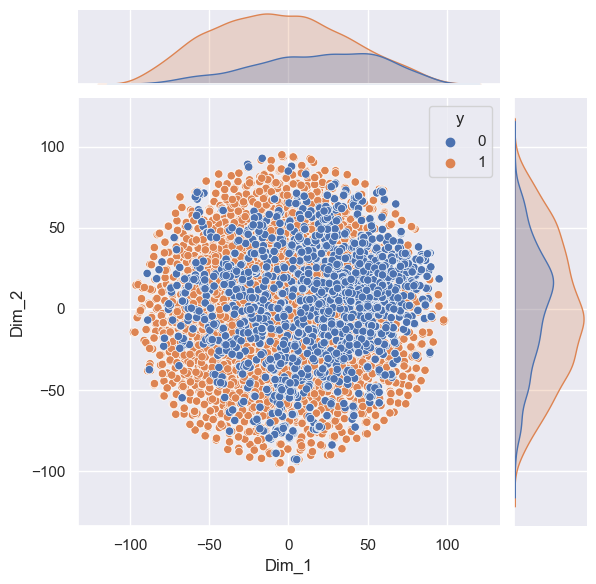

In [13]:
from sklearn.manifold import TSNE
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

if True:
    model = TSNE(n_components=2, perplexity=4, random_state=0)
    tsne_data = model.fit_transform(X_array.reshape(X_array.shape[0], number_of_bands * temporal_samples))
    tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2"))
    tsne_data = pd.concat([tsne_df, pd.DataFrame(labels, columns=['y'])], axis=1)
    tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2", "y"))

    sns.jointplot(data=tsne_df, x="Dim_1", y="Dim_2", hue='y')
    plt.show()
    warnings.filterwarnings('default')

## Visualize samples

In [14]:
if False:
    for i in range(0,3):
        # This is what a positive sample looks like
        ax = sns.heatmap(X_array[i], annot=True, cmap="viridis", vmin=-2, vmax=2, xticklabels=range(1,13), yticklabels=timestamp_tracking[i], fmt='.2f', annot_kws={"fontsize":8})
        ax.set(xlabel="Band", ylabel="Image date")
        ax.set(title = 'L12 Hex: ' + hexes[i])
        plt.show()
   

    for i in range(-4,-1):
        # This is what a negative sample looks like
        ax = sns.heatmap(X_array[i], annot=True, cmap="rocket", vmin=-2, vmax=2, xticklabels=range(1,13), yticklabels=timestamp_tracking[i], fmt='.2f', annot_kws={"fontsize":8})
        ax.set(xlabel="Band", ylabel="Image date")
        ax.set(title = 'L12 Hex: ' + hexes[i])
        plt.show()

In [15]:
import pandas as pd
import seaborn as sns

if False:
    value_vars = [i for i in df.columns if i.startswith('B')]
    id_vars = ['label']
    data = pd.melt(df, id_vars=id_vars, value_vars=value_vars)

    sns.set(rc={'figure.figsize':(11,8)})
    sns.boxplot(x="variable", y="value", hue='label', data=data)

## Check correlation among bands

<AxesSubplot:>

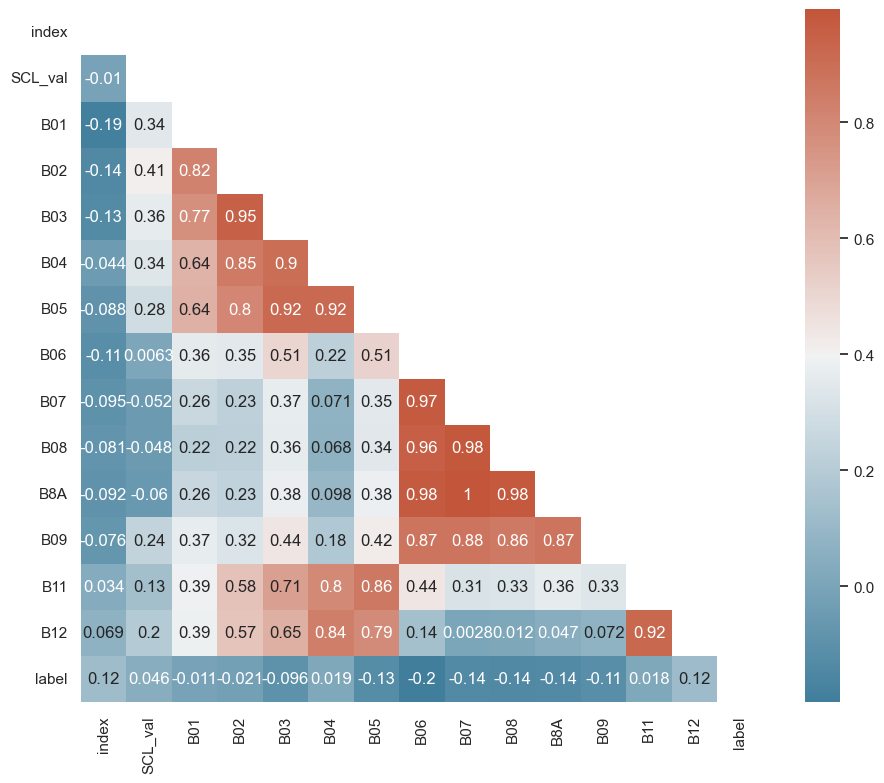

In [16]:
sns.set_theme(style="white")
# Compute the correlation matrix
corr = df.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
#sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
#            square=True, linewidths=.5, cbar_kws={"shrink": .5})

sns.heatmap(corr,mask=mask,cmap=cmap, annot=True )

In [17]:
print(X_array.shape)

(7115, 15, 12)


<AxesSubplot:>

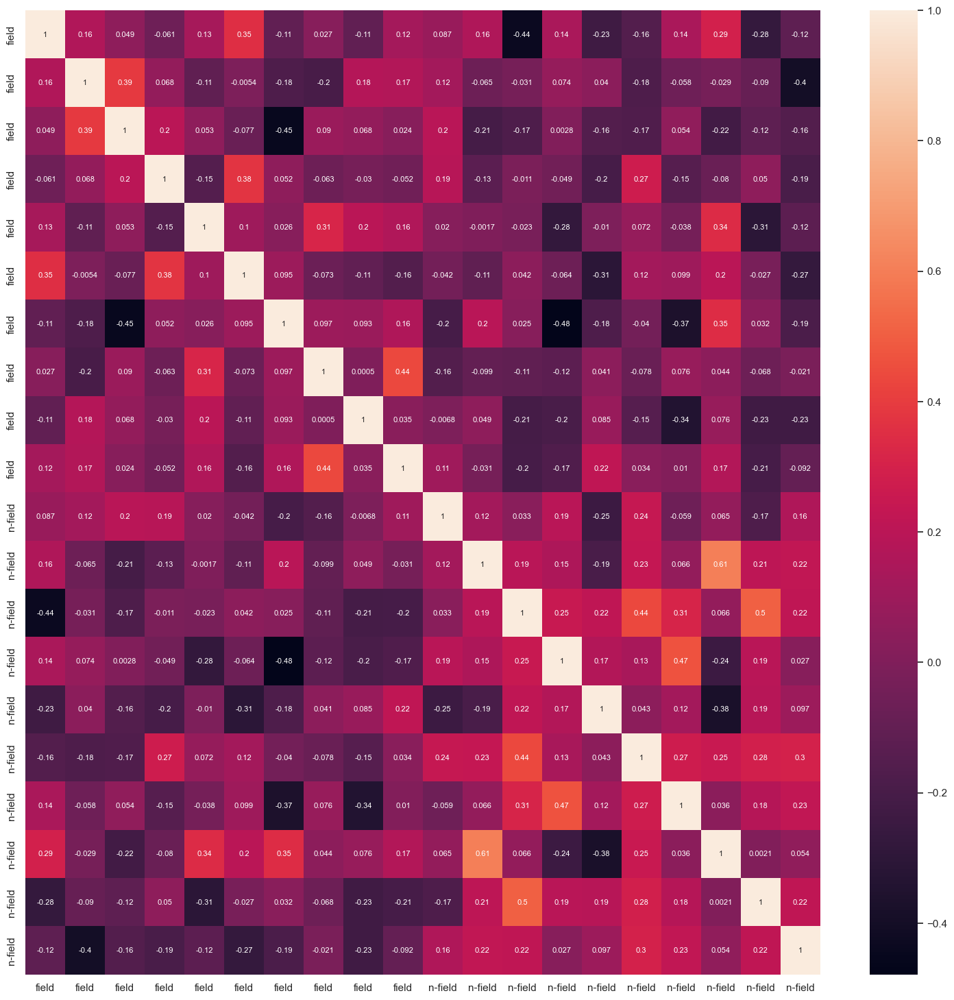

In [18]:
from sklearn import preprocessing
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics.pairwise import euclidean_distances

number_of_hexes = 10

X_array_positive = X_array[np.array(labels)==1][:number_of_hexes]
X_array_negative = X_array[np.array(labels)==0][:number_of_hexes]
X_array_samples = np.concatenate([X_array_positive, X_array_negative])
df_labels = np.concatenate((np.repeat('field',number_of_hexes), np.repeat('n-field', number_of_hexes)))

similarities = cosine_similarity(X_array_samples.reshape(number_of_hexes * 2, number_of_bands * temporal_samples), X_array_samples.reshape(number_of_hexes * 2,number_of_bands * temporal_samples))

sns.heatmap(similarities, xticklabels=df_labels, yticklabels=df_labels, annot=True, annot_kws={"fontsize":8} )

## 2.1 Prepare the Dataset

In [19]:
print('Total of samples:', X_array.shape)

labels_and_hexes = np.vstack((hexes, labels)).T

# 80% for training, 10% test and 10% validation
X_train, X_test, yl_train, yl_test = train_test_split(X_array, labels_and_hexes, test_size=0.2, random_state=42)
X_val, X_test, yl_val, yl_test = train_test_split(X_test, yl_test, test_size=0.5, random_state=42)

labeled_train_samples = X_train.shape[0]
hexes_train, y_train = np.hsplit(yl_train, 2)
hexes_test, y_test = np.hsplit(yl_test, 2)
hexes_val, y_val = np.hsplit(yl_val, 2)

y_val = np.array(y_val).T[0]
y_test = np.array(y_test).T[0]
y_train = np.array(y_train).T[0]
hexes_val = np.array(hexes_val).T[0]
hexes_test = np.array(hexes_test).T[0]
hexes_train = np.array(hexes_train).T[0]


y_train = y_train.astype(np.int)
y_test = y_test.astype(np.int)
y_val = y_val.astype(np.int)

print('Total of training samples:',X_train.shape, len(y_train))
print('Total of test samples:', X_test.shape, len(y_test))
print('Total of validation samples:', X_val.shape, len(y_val))
print(sum(np.array(y_train)==0),sum(np.array(y_train)==1))
print(sum(np.array(y_test)==0),sum(np.array(y_test)==1))
print(sum(np.array(y_val)==0),sum(np.array(y_val)==1))

Total of samples: (7115, 15, 12)
Total of training samples: (5692, 15, 12) 5692
Total of test samples: (712, 15, 12) 712
Total of validation samples: (711, 15, 12) 711
1646 4046
190 522
213 498


In [20]:
df_classes = pd.DataFrame(y_val, columns=['label'])
df_hexes = pd.DataFrame(hexes_val, columns=['hex'])

df_predict = pd.concat([df_hexes,df_classes], axis=1)

center = h3.h3_to_geo_boundary(h=df_predict.iloc[0]['hex'],geo_json=True)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                overlay = False,
                control = True)

for index, row in df_predict.iterrows():
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    
    if row['label'] == 0:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'red', 'weight': 0.5})
    elif row['label'] == 1:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'green', 'color': 'green', 'weight': 0.5})  
    else:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'black', 'color': 'black', 'weight': 0.5})
    folium.Popup(str(row['hex'])).add_to(geo_j)

    geo_j.add_to(m)

m

In [21]:
if False:
    drop_list = np.loadtxt('drop_list.csv', delimiter=',', dtype='str')
    
    drop_index = ~np.isin(hexes_val,drop_list)
    hexes_val = hexes_val[drop_index]
    X_val = X_val[drop_index]
    y_val = y_val[drop_index]
    
    drop_index = ~np.isin(hexes_test,drop_list)
    hexes_test = hexes_test[drop_index]
    X_test = X_test[drop_index]
    y_test = y_test[drop_index]
    
if False:
    fn_list = np.loadtxt('false_negatives.csv', delimiter=',', dtype='str')
    
    fn_index = np.isin(hexes_val, fn_list)
    y_val[fn_index] = 1
    
    fn_index = np.isin(hexes_test, fn_list)
    y_test[fn_index] = 1
    
print(sum(np.array(y_train)==0),sum(np.array(y_train)==1))
print(sum(np.array(y_test)==0),sum(np.array(y_test)==1))
print(sum(np.array(y_val)==0),sum(np.array(y_val)==1))

1646 4046
190 522
213 498


In [22]:
df_classes = pd.DataFrame(y_val, columns=['label'])
df_hexes = pd.DataFrame(hexes_val, columns=['hex'])

df_predict = pd.concat([df_hexes,df_classes], axis=1)

center = h3.h3_to_geo_boundary(h=df_predict.iloc[0]['hex'],geo_json=True)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                overlay = False,
                control = True)

for index, row in df_predict.iterrows():
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    
    if row['label'] == 0:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'red', 'weight': 0.5})
    elif row['label'] == 1:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'green', 'color': 'green', 'weight': 0.5})  
    else:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'black', 'color': 'black', 'weight': 0.5})
    folium.Popup(str(row['hex'])).add_to(geo_j)

    geo_j.add_to(m)

m

In [23]:
X_train_reshaped = np.reshape(X_train, (X_train.shape[0], X_train.shape[1] * X_train.shape[2]))
X_test_reshaped = np.reshape(X_test, (X_test.shape[0], X_test.shape[1] * X_test.shape[2]))
X_val_reshaped = np.reshape(X_val, (X_val.shape[0], X_val.shape[1] * X_val.shape[2]))

## 2.2 OneClassSVM

In [24]:
from sklearn.svm import OneClassSVM
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.decomposition import PCA

X_train_positives = X_train_reshaped[np.array(y_train) == 1,:]

print(X_train_positives.shape)

model = OneClassSVM(kernel='linear', nu=0.01)
model.fit(X_train_positives)

y_val_pred = model.predict(X_val_reshaped)
y_val_pred[y_val_pred == -1] = 0
print('Accuracy on validation dataset:', accuracy_score(y_val, y_val_pred))
cf_matrix_val = confusion_matrix(y_val, y_val_pred)
print(cf_matrix_val)

y_test_pred = model.predict(X_test_reshaped)
y_test_pred[y_test_pred == -1] = 0
print('Accuracy on test dataset:', accuracy_score(y_test, y_test_pred))
cf_matrix_test = confusion_matrix(y_test, y_test_pred)
print(cf_matrix_test)

(4046, 180)
Accuracy on validation dataset: 0.7524613220815752
[[129  84]
 [ 92 406]]
Accuracy on test dataset: 0.7584269662921348
[[117  73]
 [ 99 423]]


## 2.3 Isolation Forest

In [25]:
from sklearn.ensemble import IsolationForest

clf = IsolationForest(random_state=0).fit(X_train_reshaped)
clf.predict(X_train_reshaped)

y_val_pred = clf.predict(X_val_reshaped)
y_val_pred[y_val_pred == -1] = 0
print('Accuracy on validation dataset:', accuracy_score(y_val, y_val_pred))
cf_matrix_val = confusion_matrix(y_val, y_val_pred)
print(cf_matrix_val)

y_test_pred = clf.predict(X_test_reshaped)
y_test_pred[y_test_pred == -1] = 0
print('Accuracy on test dataset:', accuracy_score(y_test, y_test_pred))
cf_matrix_val = confusion_matrix(y_test, y_test_pred)
print(cf_matrix_val)

Accuracy on validation dataset: 0.6835443037974683
[[  1 212]
 [ 13 485]]
Accuracy on test dataset: 0.7148876404494382
[[  1 189]
 [ 14 508]]


## 2.3 Balance data

In [26]:
from imblearn.under_sampling import RandomUnderSampler

rus = RandomUnderSampler(random_state=42)
X_rus, y_rus = rus.fit_resample(X_train_reshaped, y_train)
h_rus = hexes_train[rus.sample_indices_]

print(X_rus.shape, np.array(y_rus).shape, np.array(h_rus).shape)

print(sum(np.array(y_train)==0),sum(np.array(y_train)==1))
print(sum(np.array(y_rus)==0),sum(np.array(y_rus)==1))

(3292, 180) (3292,) (3292,)
1646 4046
1646 1646


In [27]:
import baggingPU
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC

#bc = baggingPU.BaggingClassifierPU(RandomForestClassifier(n_estimators=20, random_state=2019), 
#bc = baggingPU.BaggingClassifierPU(MLPClassifier(hidden_layer_sizes=(300,), max_iter=300, random_state=2019), 
bc = baggingPU.BaggingClassifierPU(SVC(gamma='auto'), 
                         n_estimators = 50, 
                         n_jobs = -1, 
                         max_samples = sum(y_rus)  # Each training sample will be balanced 
                        )
bc.fit(X_rus, y_rus)

BaggingClassifierPU(base_estimator=SVC(gamma='auto'), max_samples=1646,
                    n_estimators=50, n_jobs=-1)

In [32]:
from sklearn.metrics import precision_score,recall_score,accuracy_score,f1_score, confusion_matrix,matthews_corrcoef

y_pred = bc.predict(X_val_reshaped)
print('Validation Dataset')
print('Precision: ', precision_score(y_val, y_pred))
print('Recall: ', recall_score(y_val, y_pred))
print('Accuracy: ', accuracy_score(y_val, y_pred))
print('F1: ', f1_score(y_val, y_pred))
m = confusion_matrix(y_val, y_pred)
print('F1 Acc by Class', (m.diagonal()/m.sum(axis=1)))
print(confusion_matrix(y_val, y_pred))

print(
      '%.2f'  % (float(accuracy_score(y_val, y_pred))*100) + '\\%&',
      '%.2f' % float(f1_score(y_val, y_pred, average='weighted')*100)+ '\\%&',
      '%.2f' % float(f1_score(y_val, y_pred, average=None)[0]*100)+ '\\%&',
      '%.2f' % float(f1_score(y_val, y_pred, average=None)[1]*100)+ '\\%&',
      '%.2f' % matthews_corrcoef(y_val, y_pred) + '\\\\',
     )

print('Test Dataset')
print('Precision: ', precision_score(y_test, bc.predict(X_test_reshaped)))
print('Recall: ', recall_score(y_test, bc.predict(X_test_reshaped)))
print('Accuracy: ', accuracy_score(y_test, bc.predict(X_test_reshaped)))
print(confusion_matrix(y_test, bc.predict(X_test_reshaped)))

print('Train Dataset')
print('Precision: ', precision_score(y_train, bc.predict(X_train_reshaped)))
print('Recall: ', recall_score(y_train, bc.predict(X_train_reshaped)))
print('Accuracy: ', accuracy_score(y_train, bc.predict(X_train_reshaped)))
print(confusion_matrix(y_train, bc.predict(X_train_reshaped)))

Validation Dataset
Precision:  0.9678068410462777
Recall:  0.9658634538152611
Accuracy:  0.9535864978902954
F1:  0.9668341708542714
F1 Acc by Class [0.92488263 0.96586345]
[[197  16]
 [ 17 481]]
95.36\%& 95.36\%& 92.27\%& 96.68\%& 0.89\\
Test Dataset
Precision:  0.9691714836223507
Recall:  0.9636015325670498
Accuracy:  0.9508426966292135
[[174  16]
 [ 19 503]]
Train Dataset
Precision:  0.9889613647767185
Recall:  0.9742956005931784
Accuracy:  0.9739985945186226
[[1602   44]
 [ 104 3942]]


# Visualization of the encoded samples in the XY space

In [29]:
X_viz = X_val_reshaped
y_viz = y_val
h_viz = hexes_val

y_pred = bc.predict(X_viz)
y_pred = y_viz
df_classes = pd.DataFrame(y_pred, columns=['label'])
df_hexes = pd.DataFrame(h_viz, columns=['hex'])
accuracy_list = (y_viz==y_pred)

df_predict = pd.concat([df_hexes,df_classes], axis=1)

center = h3.h3_to_geo_boundary(h=df_predict.iloc[0]['hex'],geo_json=True)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                overlay = False,
                control = True)

for index, row in df_predict.iterrows():
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    
    if accuracy_list[index] == True:
        if row['label'] == 0:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'red', 'weight': 0.5})
        elif row['label'] == 1:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'green', 'color': 'green', 'weight': 0.5})  
        else:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'black', 'color': 'black', 'weight': 0.5})
        folium.Popup(str(row['hex'])).add_to(geo_j)
    else:
        if y_pred[index] == 1:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'blue', 'color': 'green', 'weight': 0.5})
        else:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'blue', 'color': 'red', 'weight': 0.5})
        folium.Popup(str(row['hex'])).add_to(geo_j)
    geo_j.add_to(m)

m

In [30]:
X_reshaped = np.concatenate((X_train_reshaped, X_test_reshaped, X_val_reshaped), axis=0)
hexes = np.concatenate((hexes_train,hexes_test.T[0], hexes_val.T[0]), axis=0)

print(X_train_reshaped.shape, X_test_reshaped.shape, X_val_reshaped.shape)

#X_reshaped = X_val_reshaped
#hexes = hexes_val

print(X_reshaped.shape)
print(hexes.shape)

y_pred = bc.predict(X_reshaped)

df_classes = pd.DataFrame(y_pred, columns=['label'])
df_hexes = pd.DataFrame(hexes, columns=['hex'])

df_predict = pd.concat([df_hexes,df_classes], axis=1)

display(df_predict)

center = h3.h3_to_geo_boundary(h=df_predict.iloc[0]['hex'],geo_json=True)

m = folium.Map(location=(center[0][1], center[0][0]),
                tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                attr = 'Esri',
                name = 'Esri Satellite',
                overlay = False,
                control = True)

for index, row in df_predict.iterrows():
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
    
    if row['label'] == 0:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'red', 'weight': 0.5})
    elif row['label'] == 1:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'green', 'color': 'green', 'weight': 0.5})  
    else:
        geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'black', 'color': 'black', 'weight': 0.5})
    folium.Popup(str(row['hex'])).add_to(geo_j)
    geo_j.add_to(m)

m

ValueError: all the input arrays must have same number of dimensions, but the array at index 0 has 1 dimension(s) and the array at index 1 has 0 dimension(s)

<a id='graphbased_segmentation'></a>

# 3. Graph-based segmentation

<div>
<img border="5px" src="../res/graphbasedsegmentation.png" width="1000"/>
</div>

In [ ]:
import networkx as nx
import random

N = 8
G=nx.grid_2d_graph(N,N, periodic=False)


edge_colors = []
for a,b in G.edges():
    weight = random.randint(1,100) / 100
    G[a][b]['weight'] = weight
    if weight > 0.5:
        edge_colors.append('green')
    else:
        edge_colors.append('red')


pos = dict( (n, n) for n in G.nodes() )
labels = dict( ((i, j), str(i) + ',' +str(j )) for i, j in G.nodes() )

nx.draw_networkx(G,
                 with_labels=True,
                 pos=pos,
                 font_size=10,
                 labels=labels,
                 node_shape='s',
                 edge_color=edge_colors,
                 node_size=800,
                 node_color="green",
                 style="solid",
                )

labels = nx.get_edge_attributes(G,'weight')


for a,b in labels:
    labels[(a,b)] = round(labels[(a,b)],1)

nx.draw_networkx_edge_labels(G,pos,edge_labels=labels, font_size=6)
plt.axis('off')
plt.show()

In [ ]:
threshold = 0.5

for a,b in G.edges():
    if G[a][b]['weight'] < threshold:
        G.remove_edge(a,b)

In [ ]:
nx.draw_networkx(G,
                 with_labels=True,
                 pos=pos,
                 font_size=10,
                 #labels=labels,
                 node_shape='s',
                 node_size=800,
                 node_color="green",
                 style="solid",
                )

plt.axis('off')
plt.show()

In [ ]:
from networkx.algorithms import community

# perform connected component analysis
#components = list(community.greedy_modularity_communities(G))

S = [G.subgraph(c).copy() for c in nx.connected_components(G)]

for idx,H in enumerate(S):
    random_color = list(np.random.choice(range(100,256), size=3)/256)
    cmap = [random_color] * len(H.nodes())
    
    labels = {}
    for n in H.nodes():
        labels[n] = "C" + str(idx)
    
    nx.draw_networkx(H,
                 with_labels=True,
                 pos=pos,
                 font_size=10,
                 labels=labels,
                 node_shape='s',
                 node_size=800,
                 node_color=cmap,
                 style="solid",
                )
plt.axis('off')
plt.show()

# End of Notebook